In [1]:
#https://medium.com/@stepanulyanin/implementing-grad-cam-in-pytorch-ea0937c31e82
#https://theaisummer.com/vision-transformer/
#https://www.kaggle.com/abhinand05/vision-transformer-vit-tutorial-baseline?select=train.csv
import torch
import torch.nn as nn
from torch.utils import data
from torchvision.models import vgg19
from torchvision import transforms
from torchvision import datasets
from torch.utils.data import Dataset, DataLoader

import matplotlib.pyplot as plt
import numpy as np
from sklearn.model_selection import train_test_split
import glob
import cv2

import albumentations as album

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
import os
os.chdir('/content/drive/MyDrive/Machine_Learning/Crack_Detection') 
!pwd
%ls

/content/drive/MyDrive/Machine_Learning/Crack_Detection
 AEC_model.pth
 AEC_saved_models/
 Autoencoders_Conv2d_Composites.ipynb
 Autoencoders_Conv2d.ipynb
 data/
 data_2/
 GAN/
 Instance_Segmentation/
 jx_vit_base_p16_224-80ecf9dd.pth
 map_1.jpg
 map.jpg
 Neg_01249.tif
 Pos_00045.tif
 Pos_00100.tif
'VGG19_Crack_Detection&Localization.ipynb'
 ViTransformers.ipynb
 ViTransformers_model.pth
 Yolo_v4/


In [4]:
#https://medium.com/analytics-vidhya/creating-a-custom-dataset-and-dataloader-in-pytorch-76f210a1df5d
from skimage.color import gray2rgb
class CustomDataset(Dataset):
    def __init__(self, augmentation=None):
        self.imgs_path = "data/"
        file_list = glob.glob(self.imgs_path + "*")
        print(file_list[:2])
        self.data = []
        for class_path in file_list[:2]:
            class_name = class_path.split("/")[-1]
            for img_path in glob.glob(class_path + "/*.tif"):
                self.data.append([img_path, class_name])
        self.class_map = {"Negative" : 0, "Positive": 1}
        self.img_dim = (224, 224)   
        self.augmentation = augmentation

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        img_path, class_name = self.data[idx]
        img = cv2.imread(img_path)
        if self.augmentation:
            sample = self.augmentation(image=img)
            img = sample['image']
        # converting the type of pixel to float 32
        img = img.astype('float32')
        # normalizing the pixel values
        img /= 255.0
        #
        img = cv2.resize(img, self.img_dim)
        class_id = self.class_map[class_name]
        img_tensor = torch.from_numpy(gray2rgb(img))
        img_tensor = img_tensor.permute(2, 0, 1)
        class_id = torch.tensor([class_id])
        return img_tensor.float(), class_id#.float()

def get_training_augmentation():
    train_transform = [    
        album.OneOf(
            [album.HorizontalFlip(p=1),
             album.VerticalFlip(p=1),
             album.RandomRotate90(p=1),
            ], p=0.5),
    ]
    return album.Compose(train_transform)

dataset = CustomDataset(augmentation=get_training_augmentation())
data_train, data_test = train_test_split(dataset, test_size=0.3)#, random_state=1
batch_size=32

trainloader = DataLoader(data_train, batch_size, num_workers=2, shuffle=True, drop_last=True)
testloader = DataLoader(data_test, batch_size, num_workers=2, shuffle=True, drop_last=True)

['data/Negative', 'data/Positive']


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:33: FutureWarning: Pass-through of possibly RGB images in gray2rgb is deprecated. In version 0.19, input arrays will always be considered grayscale, even if the last dimension has length 3 or 4. To prevent this warning and ensure compatibility with future versions, detect RGB images outside of this function.


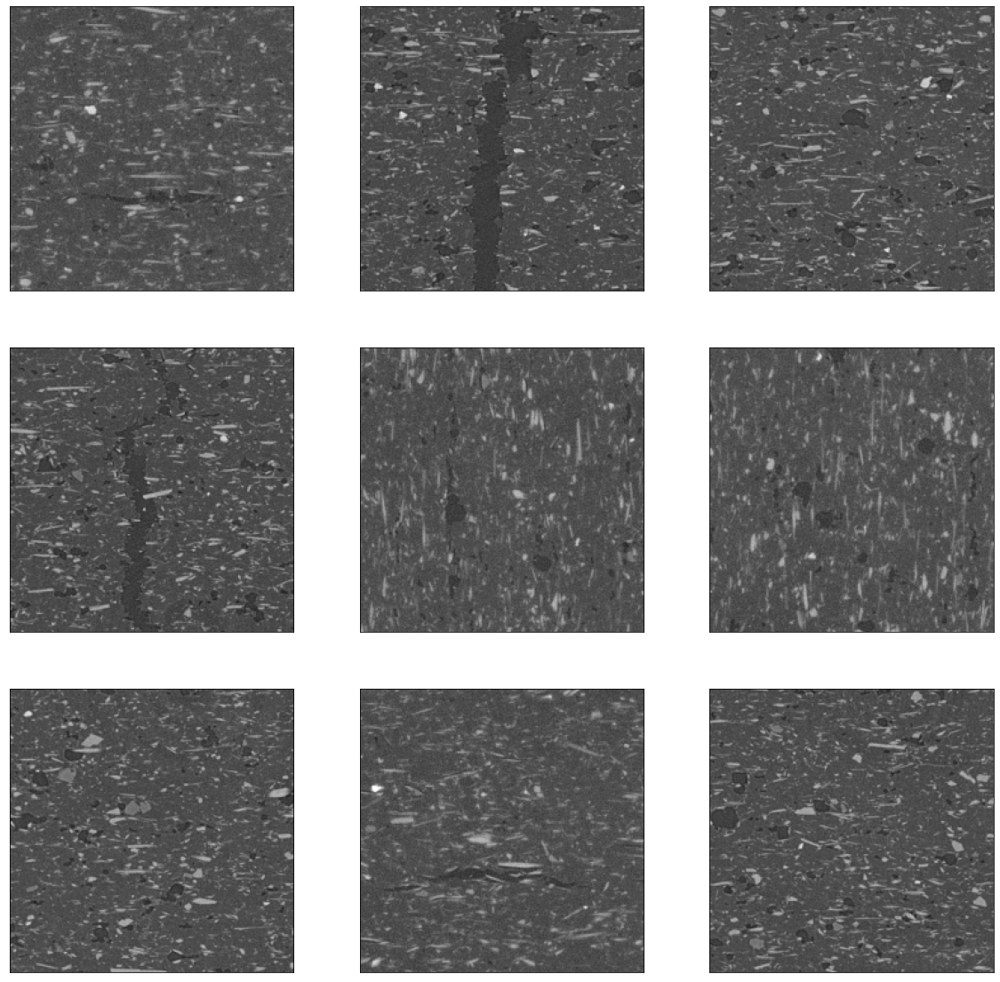

In [5]:
def imshow(img):
    plt.imshow(np.transpose(img, (1, 2, 0)), cmap = "gray", vmin= np.min(img), vmax=np.max(img)) 

#Obtain one batch of training images
dataiter = iter(trainloader)
imgs, labels = dataiter.next()
images = imgs.numpy() # convert images to numpy for display

#Plot the images
fig = plt.figure(figsize=(20, 20))
# display 9 images
for idx in np.arange(9):
    ax = fig.add_subplot(3, 3, idx+1, xticks=[], yticks=[])
    imshow(images[idx])

In [6]:
#!pip install timm
import timm
MODEL_PATH = ("jx_vit_base_p16_224-80ecf9dd.pth")

class ViTBase16(nn.Module):
    def __init__(self, n_classes, pretrained=False):

        super(ViTBase16, self).__init__()

        self.model = timm.create_model("vit_base_patch16_224", pretrained=False)
        if pretrained:
            self.model.load_state_dict(torch.load(MODEL_PATH))

        self.model.head = nn.Linear(self.model.head.in_features, n_classes)

    def forward(self, x):
        x = self.model(x)
        return x

model = ViTBase16(n_classes=2, pretrained=True)

In [7]:
#model.compile(optimizer= Adam(lr=0.0001), loss = "BinaryCrossentropy", metrics = ['acc'])

def get_device():
    if torch.cuda.is_available():
        device = 'cuda:0'
    else:
        device = 'cpu'
    return device

device = get_device()
print(device)

# initialize the VGG model
model.to(device)
#print(model)
from torchsummary import summary
summary(model,(3,224,224))

#Loss function
criterion = torch.nn.BCEWithLogitsLoss()#BCELoss()#

#Optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=0.00005)

# Load pretrained models
load_pretrained_models = True
model_path = "ViTransformers_model.pth"
if load_pretrained_models:
    model.load_state_dict(torch.load(model_path,map_location=device))

cuda:0
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 768, 14, 14]         590,592
          Identity-2             [-1, 196, 768]               0
        PatchEmbed-3             [-1, 196, 768]               0
           Dropout-4             [-1, 197, 768]               0
         LayerNorm-5             [-1, 197, 768]           1,536
            Linear-6            [-1, 197, 2304]       1,771,776
           Dropout-7         [-1, 12, 197, 197]               0
            Linear-8             [-1, 197, 768]         590,592
           Dropout-9             [-1, 197, 768]               0
        Attention-10             [-1, 197, 768]               0
         Identity-11             [-1, 197, 768]               0
        LayerNorm-12             [-1, 197, 768]           1,536
           Linear-13            [-1, 197, 3072]       2,362,368
             GELU-14            

In [8]:
def indices_to_one_hot(data, nb_classes):
    """Convert an iterable of indices to one-hot encoded labels."""
    targets = np.array(data).reshape(-1)
    return np.eye(nb_classes)[targets]

In [13]:
from torch.autograd import Variable
Tensor = torch.cuda.FloatTensor if device == 'cuda:0' else torch.FloatTensor

train_losses=[]
valid_losses=[]
best_val_loss = float('inf')

for epoch in range(1,11):  # loop over the dataset multiple times

    train_loss = 0.0

    for i, data in enumerate(trainloader, 0):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        labels = torch.from_numpy(indices_to_one_hot(labels, 2))#.type(torch.IntTensor)
        inputs.to(device)
        labels.to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        output = model(inputs.type(Tensor))

        loss = criterion(output, labels.type(Tensor))
        #loss.requres_grad = True

        loss.backward()
        optimizer.step()

        train_loss += loss.item()*inputs.size(0)

    #start validation loop
    val_loss_sum=0
    val_acc_sum=0

    with torch.no_grad():
        for i, data in enumerate(testloader, 0):
            inputs, label = data
            labels = torch.from_numpy(indices_to_one_hot(label, 2))
            inputs.to(device)
            labels.to(device)

            val_out=model(inputs.type(Tensor))
            val_loss=criterion(val_out,labels.type(Tensor))
            val_loss_sum+=val_loss.item()
            _, predics = torch.max(val_out,dim=1)
            val_acc_sum+=((predics.cpu() == np.squeeze(label)).sum().item())/len(label)

    # append training and validation loss
    train_losses.append(train_loss)
    valid_losses.append(val_loss)
        
    if (epoch)%2 == 0:         
        train_loss = train_loss/len(trainloader)
        val_loss   = val_loss_sum/len(testloader)
        val_acc    = val_acc_sum/len(testloader)
        print('Epoch: {} \tTraining Loss: {:.5f} \tTest Loss: {:.5f} \tTest accurancy: {:.3f}'.format(epoch, train_loss, val_loss, val_acc))

    # Save model checkpoints
    if (epoch)%10 == 0:
      torch.save(model.state_dict(), "ViTransformers_model.pth")
      print('save model!')

    #save the best model
    if val_loss < best_val_loss:
          best_val_loss = val_loss
          torch.save(model.state_dict(), "ViTransformers_best_model.pth")

print('Finished Training')

Epoch: 2 	Training Loss: 0.00022 	Test Loss: 0.01795 	Test accurancy: 0.993
Epoch: 4 	Training Loss: 0.00016 	Test Loss: 0.01817 	Test accurancy: 0.993
Epoch: 6 	Training Loss: 0.00013 	Test Loss: 0.01836 	Test accurancy: 0.993
Epoch: 8 	Training Loss: 0.00010 	Test Loss: 0.01859 	Test accurancy: 0.993
Epoch: 10 	Training Loss: 0.00008 	Test Loss: 0.01887 	Test accurancy: 0.993
save model!
Finished Training


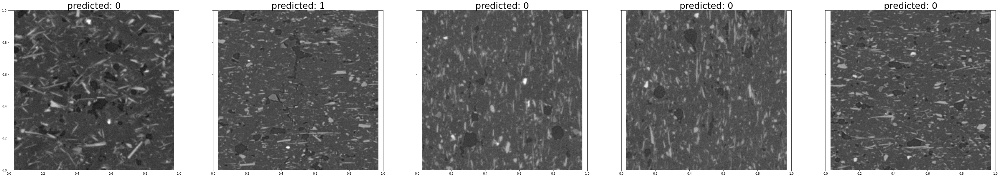

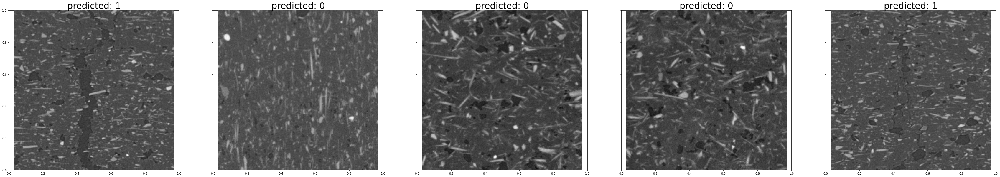

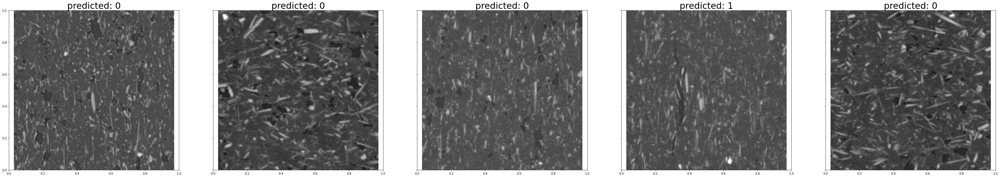

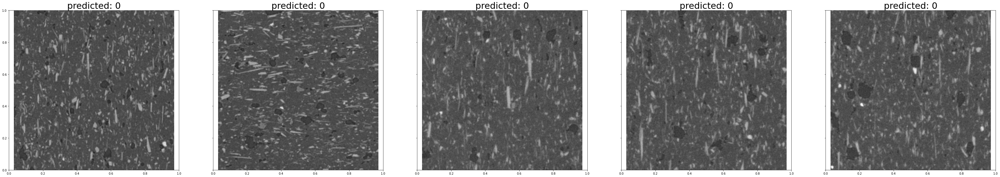

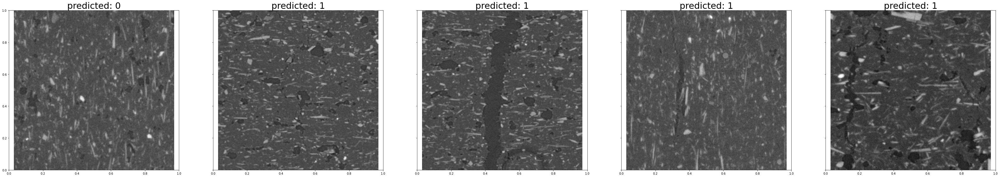

...

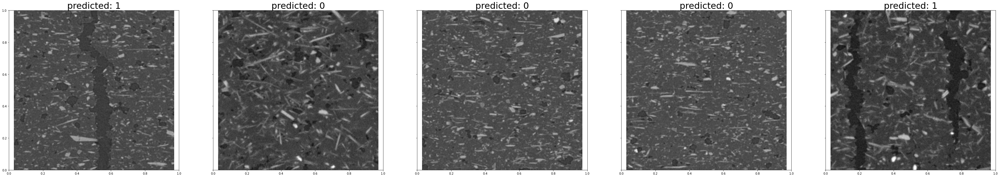

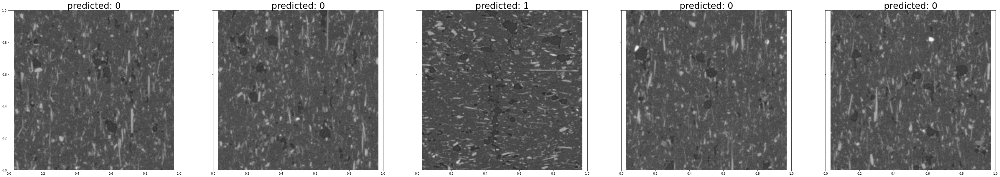

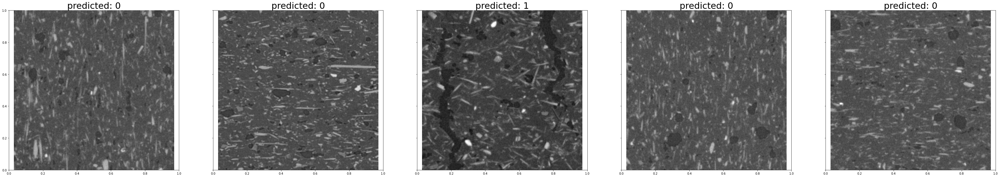

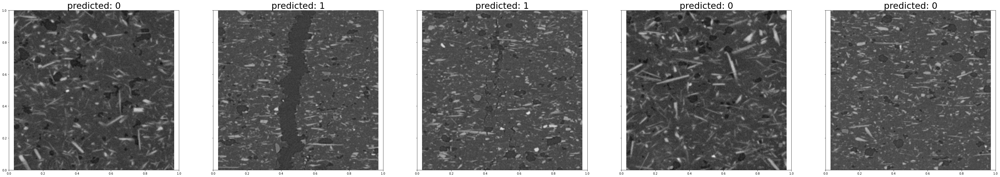

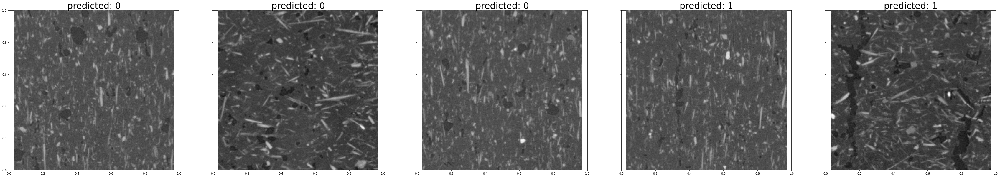

Accuracy of the network on the test images: 99 %


In [14]:
correct = 0
total = 0
# since we're not training, we don't need to calculate the gradients for our outputs
with torch.no_grad():
    for data in testloader:
        images, labels = data
        images = images.to(device)
        # calculate outputs by running images through the network
        outputs = model(images.type(Tensor))
        # the class with the highest energy is what we choose as prediction
        _, predicted = torch.max(outputs, 1)
        total += labels.size(0)
        correct += (np.squeeze(labels) == predicted.cpu()).sum().item()

        img  = images.cpu()
        imgs = img.numpy()

        fig, axes = plt.subplots(nrows=1, ncols=5, sharex=True, sharey=True, figsize=(60,10))
        for idx in np.arange(5):
            ax = fig.add_subplot(1, 5, idx+1, xticks=[], yticks=[])
            ax.axis('off')
            ax.set_title('predicted: {}'.format(predicted[idx]), fontsize=30)
            imshow(imgs[idx])
        plt.show()

print('Accuracy of the network on the test images: %d %%' % (100 * correct / total))